# Exploration of *in vitro* Data

Imports

In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

In [7]:
def calculate_fs(df, key):
    df_count = df.groupby(key+["type"]).count().reset_index()
    df_sum = df_count.groupby(key)["x"].sum()
    df_sum = df_sum.reset_index()
    df_sum = df_sum.rename(columns={"x":"TotalCells"})
    df_sens = df_count[df_count["type"] == "sensitive"]
    df_sens = df_sum.merge(df_sens, on=key)
    df_sens["fs"] = df_sens["x"]/df_sens["TotalCells"]
    df_sens = df_sens[key+["fs"]]
    df = df.merge(df_sens, on=key)
    return df

Read in data

In [3]:
df = pd.read_csv("../data/in_vitro/processed/spatial_braf.csv")

### Visualize fraction sensitive in each well

[Text(0.5, 1.0, 'Fraction Sensitive')]

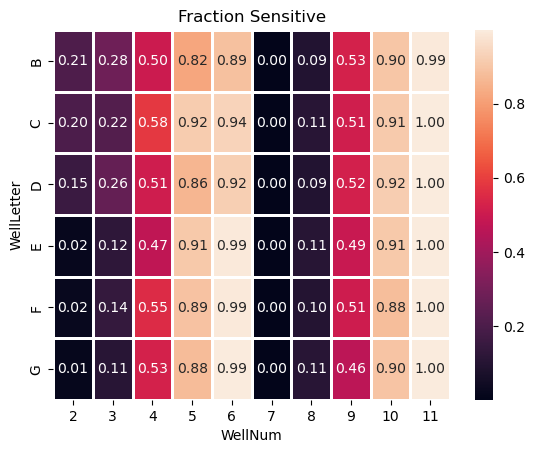

In [25]:
key = ["WellId", "PlateId"]
df_hm = calculate_fs(df, key)
df_hm["WellLetter"] = df_hm["WellId"].str[0]
df_hm["WellNum"] = df_hm["WellId"].str[1:].astype(int)
df_hm = df_hm[["WellLetter", "WellNum", "fs"]].drop_duplicates()
df_hm = df_hm.pivot(index="WellLetter", columns="WellNum", values="fs")
ax = sns.heatmap(df_hm, annot=True, fmt=".2f", linewidth=1)
ax.set(title="Fraction Sensitive")

### Visualize plate

In [14]:
def plot_plate_section(df, well_letters, well_nums):
    num_letters = len(well_letters)
    num_nums = len(well_nums)
    fig, ax = plt.subplots(num_letters, num_nums, figsize=(10*num_nums, 10*num_letters))
    for l in range(len(well_letters)):
        for n in range(len(well_nums)):
            well = well_letters[l]+str(well_nums[n])
            sns.scatterplot(data=df[df["WellId"] == well], x="x", y="y", 
                            hue="type", legend=False, ax=ax[l][n],
                            palette=["#4C956C", "#EF7C8E"], 
                            hue_order=["sensitive", "resistant"])
            ax[l][n].set(xlabel="", ylabel="")
            ax[l][n].get_xaxis().set_ticks([])
            ax[l][n].get_yaxis().set_ticks([])
            ax[l][n].set_facecolor("lightgrey")
    fig.patch.set_alpha(0.0)
    fig.tight_layout()
    plt.show()

High concentration

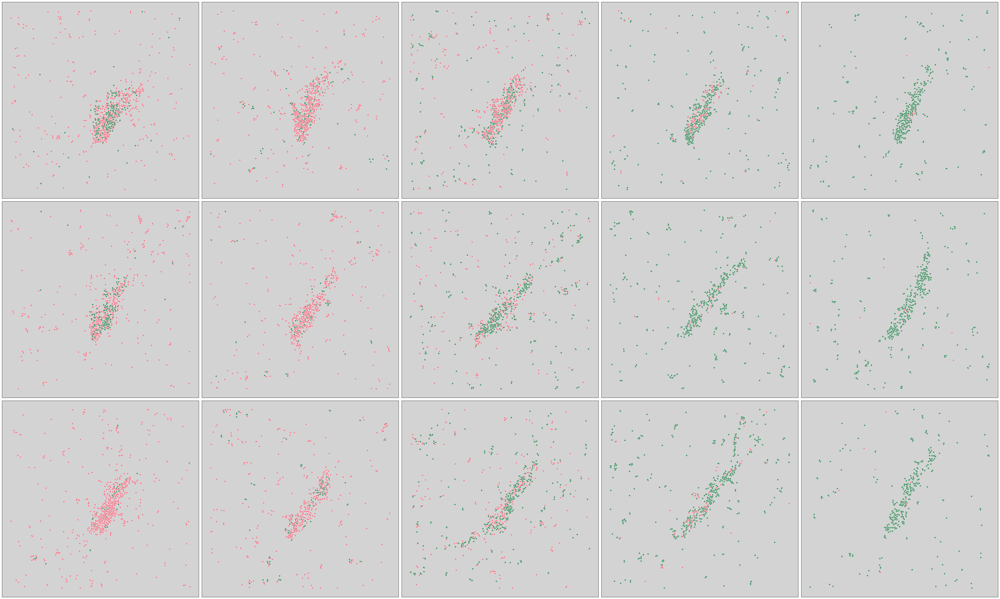

In [15]:
plot_plate_section(df, ["B", "C", "D"], [2, 3, 4, 5, 6])

Medium concentration

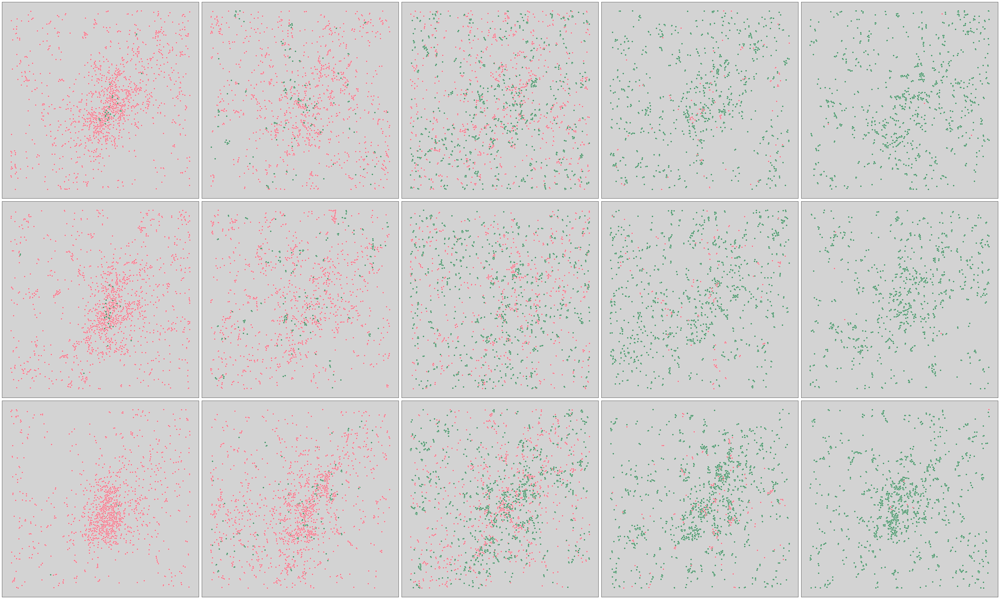

In [16]:
plot_plate_section(df, ["E", "F", "G"], [2, 3, 4, 5, 6])

Low concentration

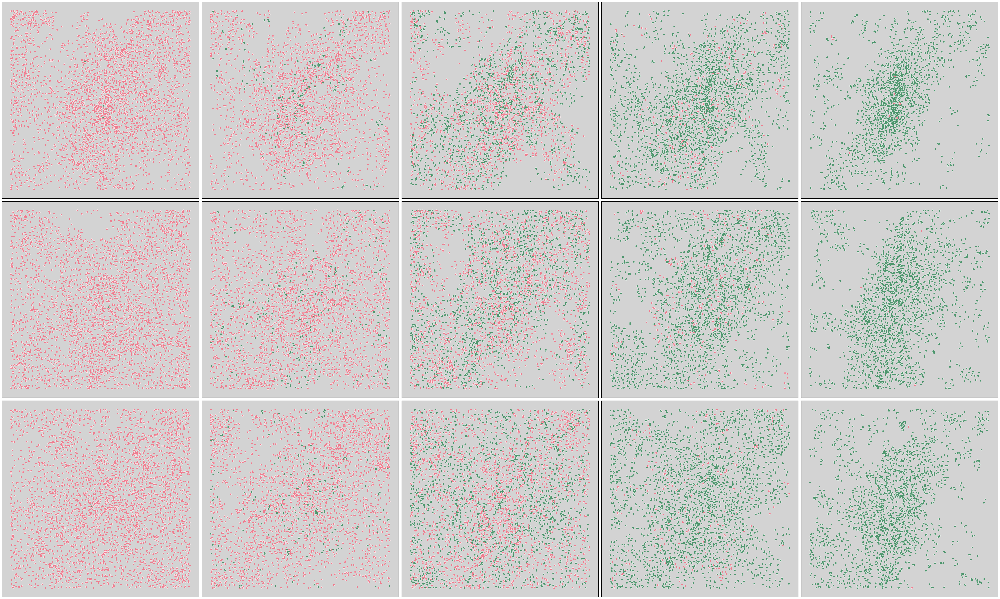

In [17]:
plot_plate_section(df, ["B", "C", "D"], [7, 8, 9, 10, 11])

Control

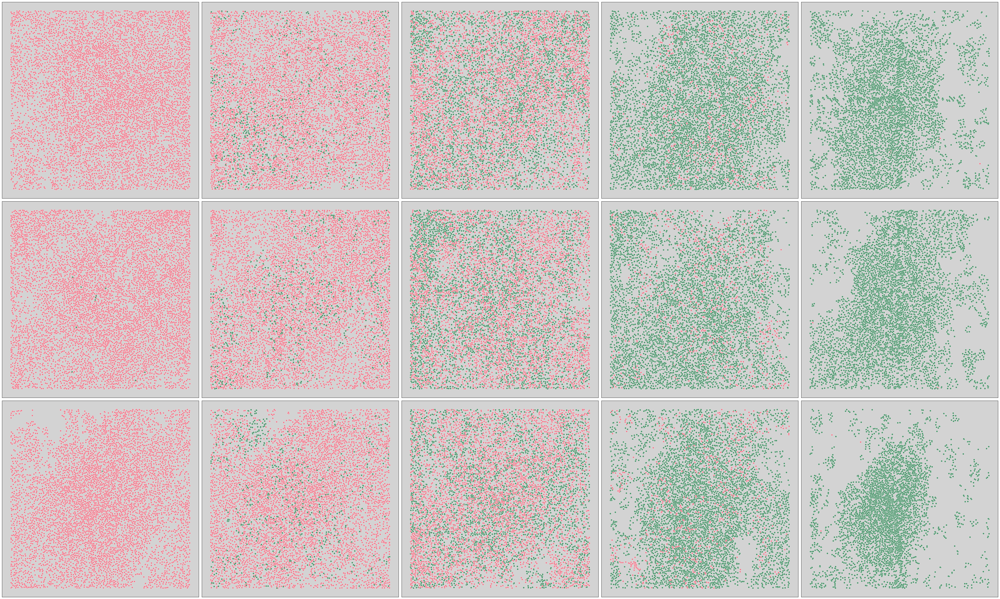

In [18]:
plot_plate_section(df, ["E", "F", "G"], [7, 8, 9, 10, 11])

One well

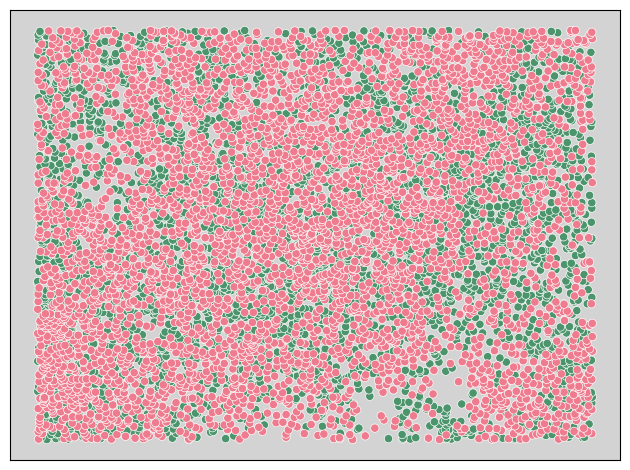

In [19]:
well = "G9"
fig, ax = plt.subplots()
sns.scatterplot(data=df[df["WellId"] == well], x="x", y="y", 
                hue="type", legend=False, ax=ax,
                palette=["#4C956C", "#EF7C8E"], 
                hue_order=["sensitive", "resistant"])
ax.set(xlabel="", ylabel="")
ax.get_xaxis().set_ticks([])
ax.get_yaxis().set_ticks([])
ax.set_facecolor("lightgrey")
fig.patch.set_alpha(0.0)
fig.tight_layout()